# SECTION 4

## VIDEO 2 - color mapings

In [1]:
import cv2
import matplotlib.pyplot as plt
%matplotlib inline

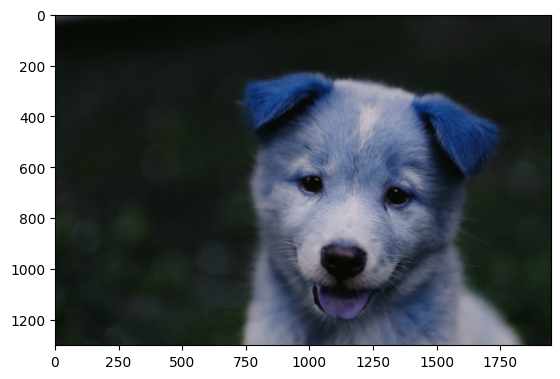

In [2]:
img = cv2.imread("DATA/00-puppy.jpg")
plt.imshow(img)

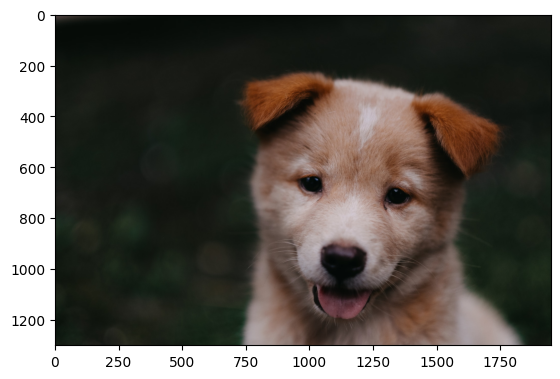

In [3]:
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)

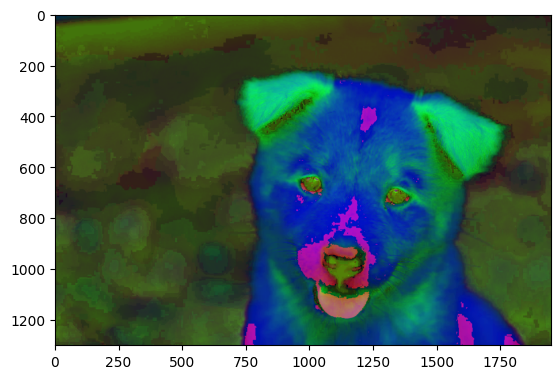

In [4]:
img = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
plt.imshow(img)

## VIDEO 3 - blending images

In [6]:
import cv2

In [14]:
img1 = cv2.imread("DATA/dog_backpack.png")
img1 = cv2.cvtColor(img1,cv2.COLOR_BGR2RGB)
img2 = cv2.imread("DATA/watermark_no_copy.png")
img2 = cv2.cvtColor(img2,cv2.COLOR_BGR2RGB)

In [9]:
import matplotlib.pyplot as plt
%matplotlib inline

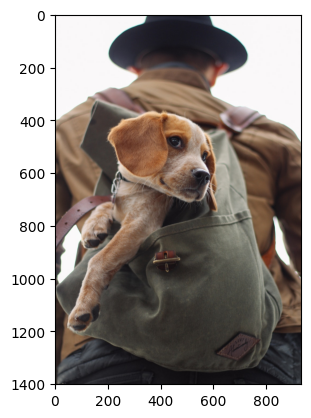

In [11]:
plt.imshow(img1)

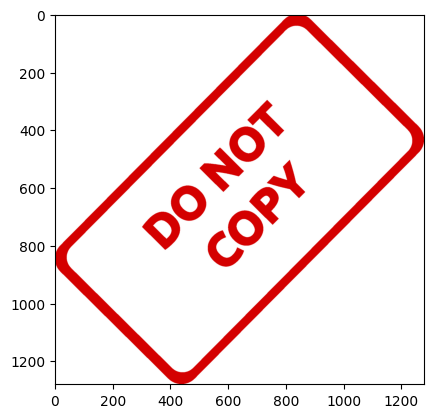

In [15]:
plt.imshow(img2)

In [18]:
# BLENDING IMAGES OF THE SAME SIZE

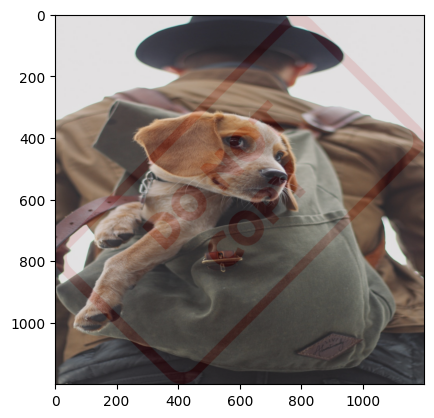

In [22]:
img1 = cv2.resize(img1, (1200,1200))
img2 = cv2.resize(img2, (1200,1200))

blended = cv2.addWeighted(src1= img1, alpha=0.8, src2=img2, beta=0.1, gamma=0)
plt.imshow(blended)

In [25]:
# OVERLAY SMALL IMAGE ON TOP OF A LARGER IMAGE (NO BLENDING)
# Numpy reassignment

In [ ]:
img1 = cv2.imread("DATA/dog_backpack.png")
img1 = cv2.cvtColor(img1,cv2.COLOR_BGR2RGB)
img2 = cv2.imread("DATA/watermark_no_copy.png")
img2 = cv2.cvtColor(img2,cv2.COLOR_BGR2RGB)

In [27]:
img2 = cv2.resize(img2, (600,600))

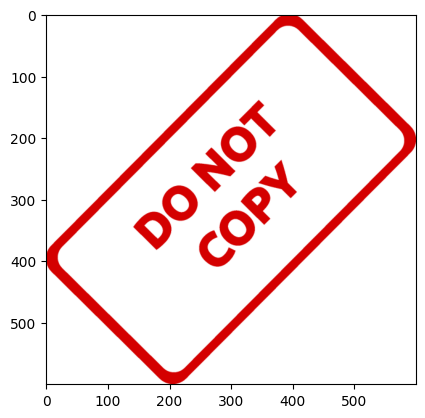

In [28]:
plt.imshow(img2)

In [35]:
large_img = img1
small_img = img2

In [36]:
x_offset = 0
y_offset = 0

In [37]:
x_end = x_offset + small_img.shape[1]
y_end = y_offset + small_img.shape[0]

In [38]:
large_img[y_offset:y_end,x_offset:x_end] = small_img

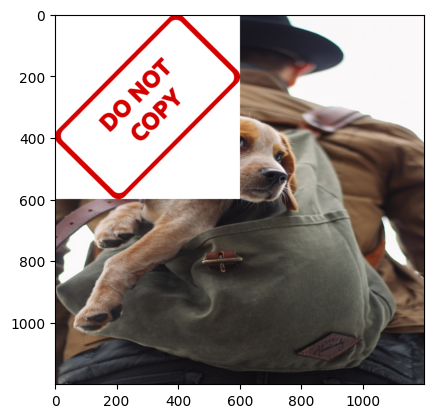

In [39]:
plt.imshow(large_img)

In [40]:
# BLEND TOGETHER IMAGES OF DIFFERENT SIZES

In [41]:
img1 = cv2.imread("DATA/dog_backpack.png")
img1 = cv2.cvtColor(img1,cv2.COLOR_BGR2RGB)
img2 = cv2.imread("DATA/watermark_no_copy.png")
img2 = cv2.cvtColor(img2,cv2.COLOR_BGR2RGB)

In [42]:
img2 = cv2.resize(img2,(600,600))

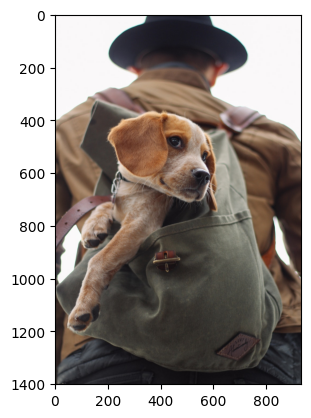

In [44]:
plt.imshow(img1)

In [46]:
img1.shape

(1401, 934, 3)

In [48]:
x_offset = 934 - 600
y_offset = 1401 - 600

In [50]:
rows,cols,changels = img2.shape

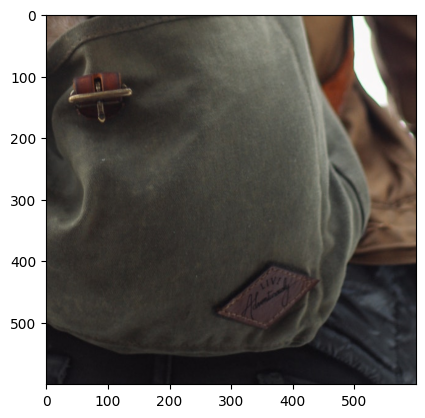

In [53]:
roi = img1[y_offset:1401, x_offset:934]
plt.imshow(roi)

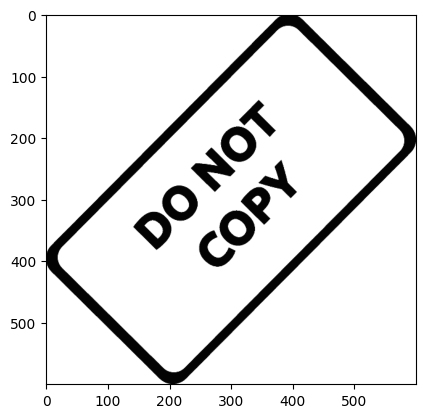

In [57]:
img2gray = cv2.cvtColor(img2, cv2.COLOR_RGB2GRAY)
plt.imshow(img2gray,cmap='gray')

In [58]:
mask_inv = cv2.bitwise_not(img2gray)

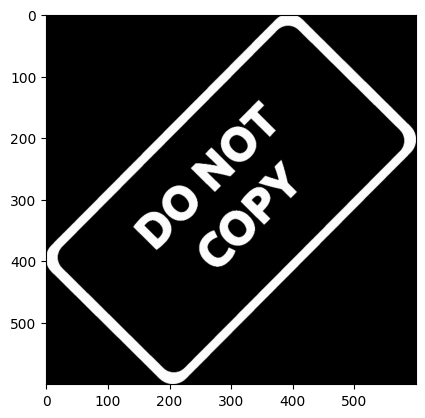

In [59]:
plt.imshow(mask_inv, cmap='gray')

In [60]:
import numpy as np
white_background = np.full(img2.shape,255,dtype=np.uint8)

In [61]:
# white_background

In [62]:
bk = cv2.bitwise_or(white_background,white_background,mask=mask_inv)
bk.shape

(600, 600, 3)

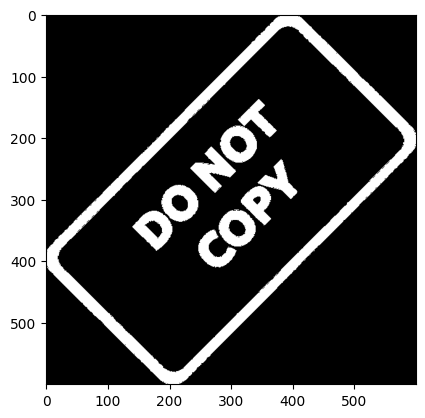

In [63]:
plt.imshow(bk)

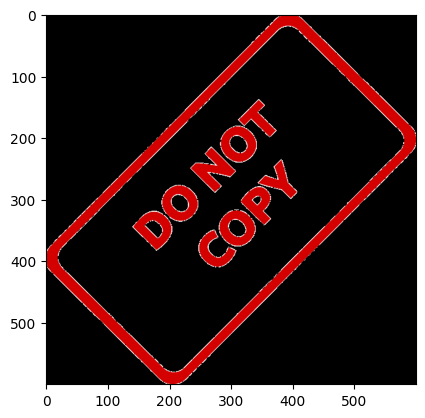

In [64]:
fg = cv2.bitwise_or(img2,img2, mask=mask_inv)
plt.imshow(fg)

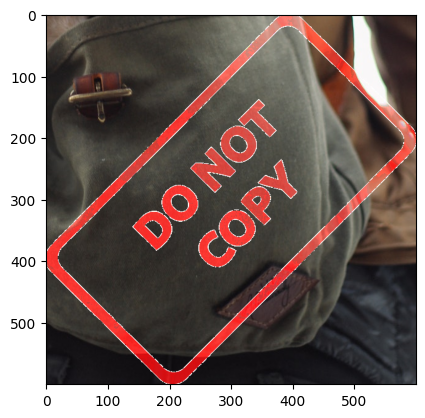

In [65]:
final_roi = cv2.bitwise_or(roi,fg)
plt.imshow(final_roi)

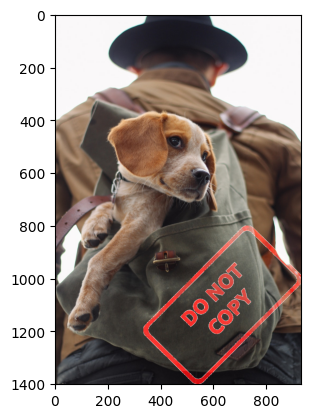

In [67]:
large_img = img1
small_img = final_roi

large_img[y_offset:y_offset+small_img.shape[0],x_offset:x_offset+small_img.shape[1]] = small_img

plt.imshow(large_img)

## IMAGE THRESHOLDING

In [68]:
import cv2
import matplotlib.pyplot as plt
%matplotlib inline

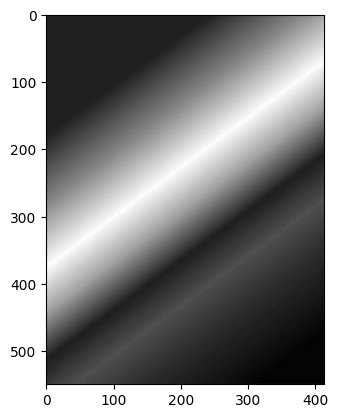

In [71]:
img = cv2.imread('DATA/rainbow.jpg',0)
plt.imshow(img,cmap='gray')

In [77]:
ret,thresh1 = cv2.threshold(img,127,255,cv2.THRESH_TRUNC)



In [75]:
ret

127.0

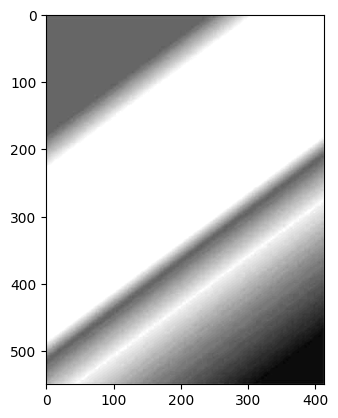

In [78]:
plt.imshow(thresh1, cmap='gray')

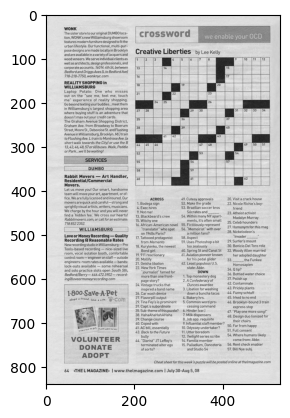

In [79]:
img = cv2.imread('DATA/crossword.jpg',0)
plt.imshow(img,cmap='gray')

In [80]:
def show_pic(img):
  fig = plt.figure(figsize=(15,15))
  ax = fig.add_subplot(111)
  ax.imshow(img,cmap='gray')

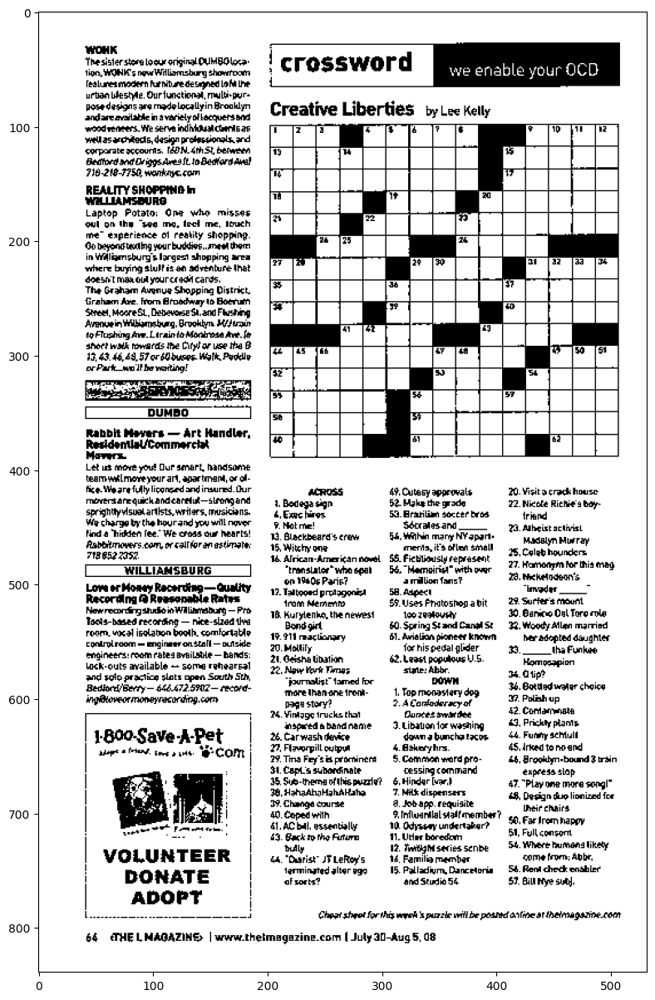

In [83]:
ret, th1 = cv2.threshold(img,170,255,cv2.THRESH_BINARY)
show_pic(th1)

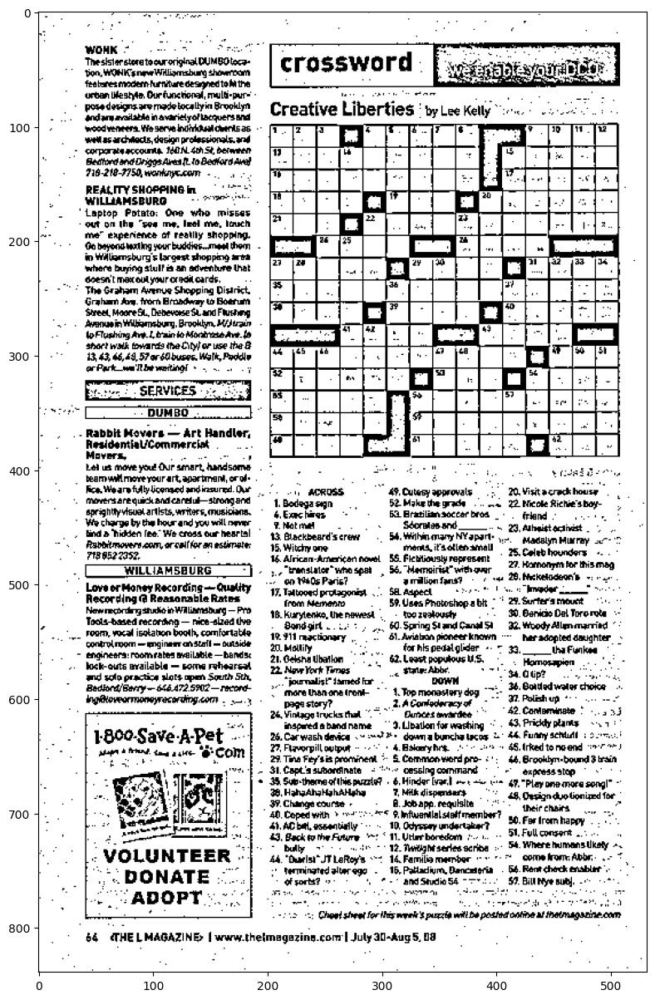

In [89]:
th2 = cv2.adaptiveThreshold(img, 255, cv2.ADAPTIVE_THRESH_MEAN_C,cv2.THRESH_BINARY,11,8)
show_pic(th2)

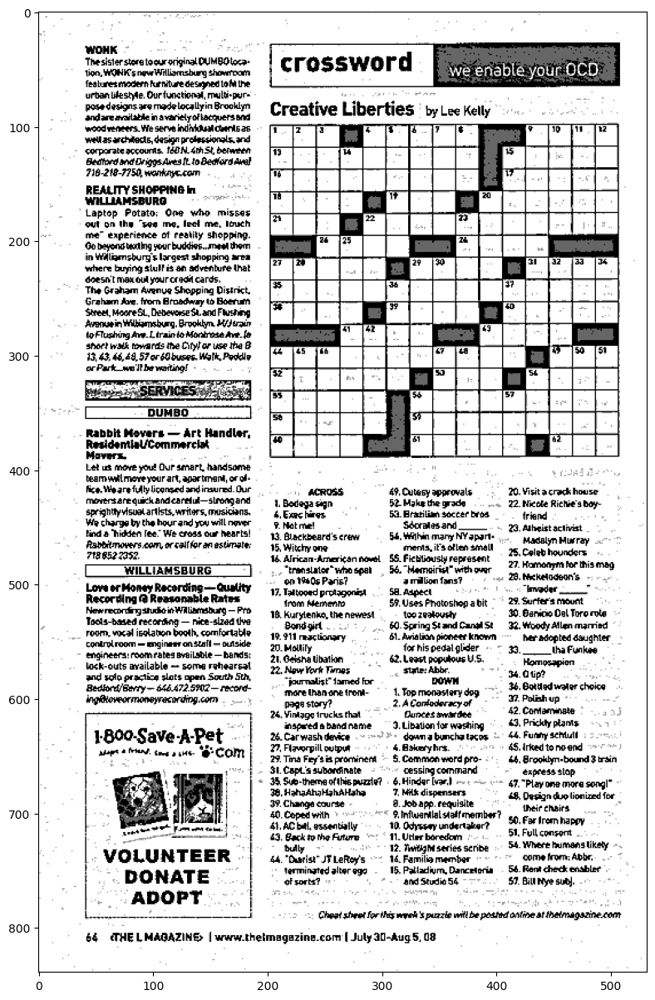

In [91]:
blended = cv2.addWeighted(th1,0.6,th2,0.4,0)
show_pic(blended)

## BLUR AND SMOOTH

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
def load_img():
  img = cv2.imread('DATA/bricks.jpg').astype(np.float32) / 255
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  return img

In [3]:
# load_img()

In [4]:
def display_img(img):
  fig = plt.figure(figsize=(12,10))
  ax = fig.add_subplot(111)
  ax.imshow(img)

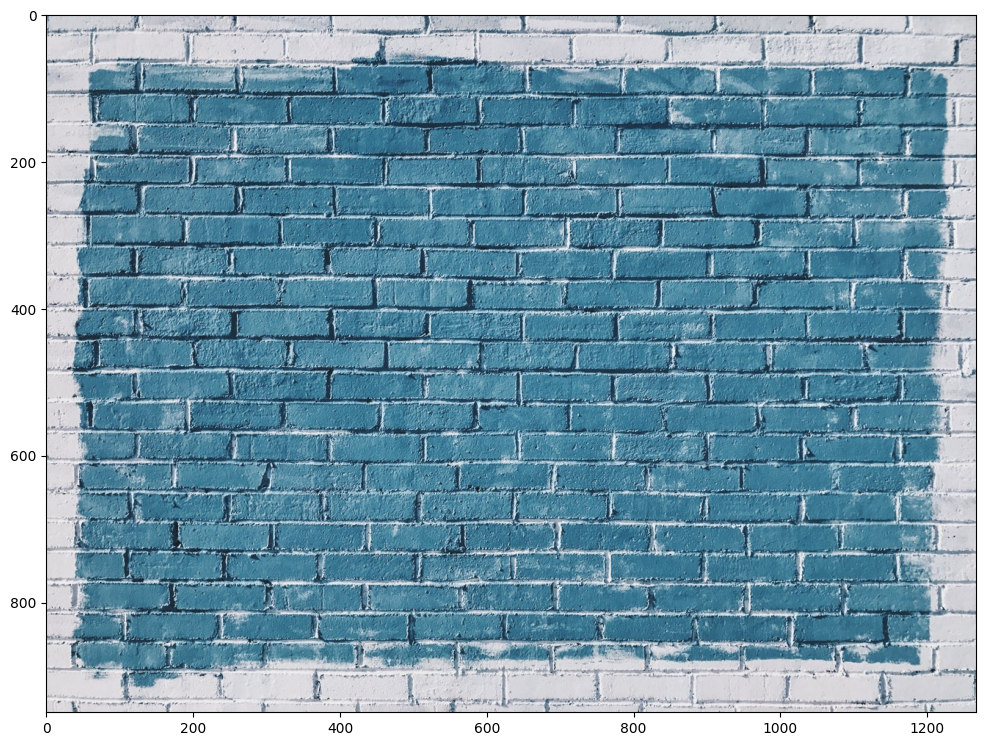

In [12]:
i = load_img()
display_img(i)

In [6]:
gamma = 1/4

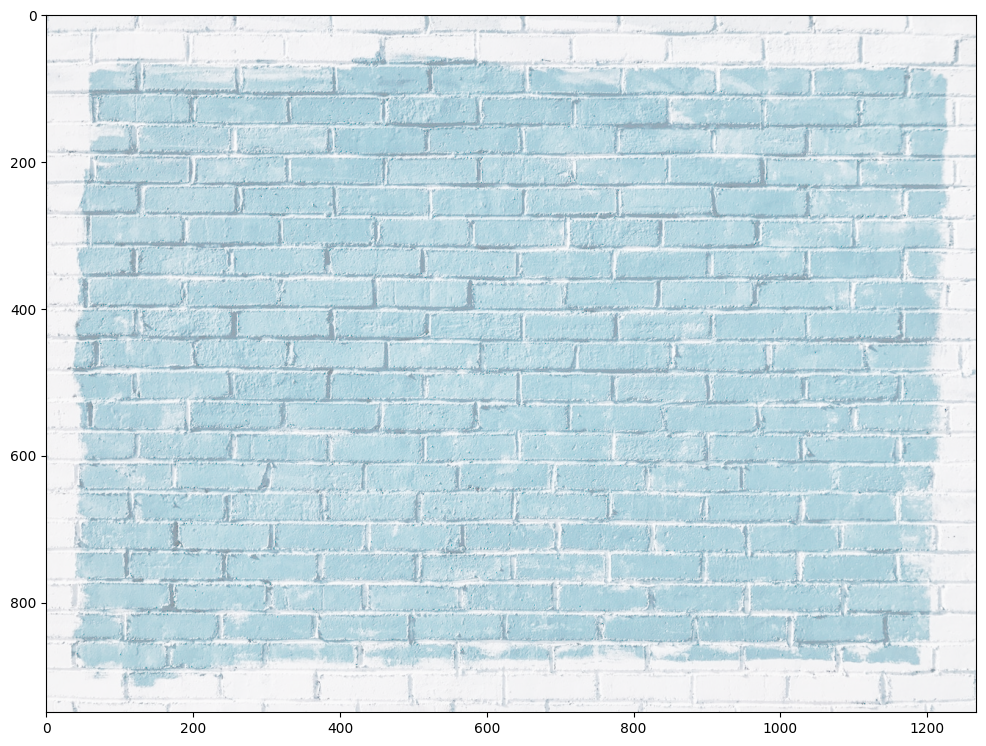

In [9]:
result = np.power(i,gamma)
display_img(result)

In [39]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img,text='bricks', org=(10,600), fontFace=font,fontScale=10,color=(255,0,0),thickness=2)


array([[[0.78431374, 0.7882353 , 0.80784315],
        [0.7529412 , 0.77254903, 0.79607844],
        [0.7254902 , 0.7647059 , 0.8       ],
        ...,
        [0.7764706 , 0.76862746, 0.7882353 ],
        [0.7764706 , 0.76862746, 0.7882353 ],
        [0.7764706 , 0.76862746, 0.7882353 ]],

       [[0.8784314 , 0.88235295, 0.9019608 ],
        [0.7647059 , 0.78431374, 0.80784315],
        [0.7019608 , 0.7529412 , 0.78431374],
        ...,
        [0.7764706 , 0.76862746, 0.7882353 ],
        [0.7764706 , 0.76862746, 0.7882353 ],
        [0.7764706 , 0.76862746, 0.7882353 ]],

       [[0.85490197, 0.8666667 , 0.89411765],
        [0.6509804 , 0.6784314 , 0.70980394],
        [0.4862745 , 0.5372549 , 0.57254905],
        ...,
        [0.7764706 , 0.76862746, 0.7882353 ],
        [0.7764706 , 0.76862746, 0.7882353 ],
        [0.7764706 , 0.76862746, 0.7882353 ]],

       ...,

       [[0.8509804 , 0.83137256, 0.84705883],
        [0.84705883, 0.827451  , 0.84313726],
        [0.84313726, 0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


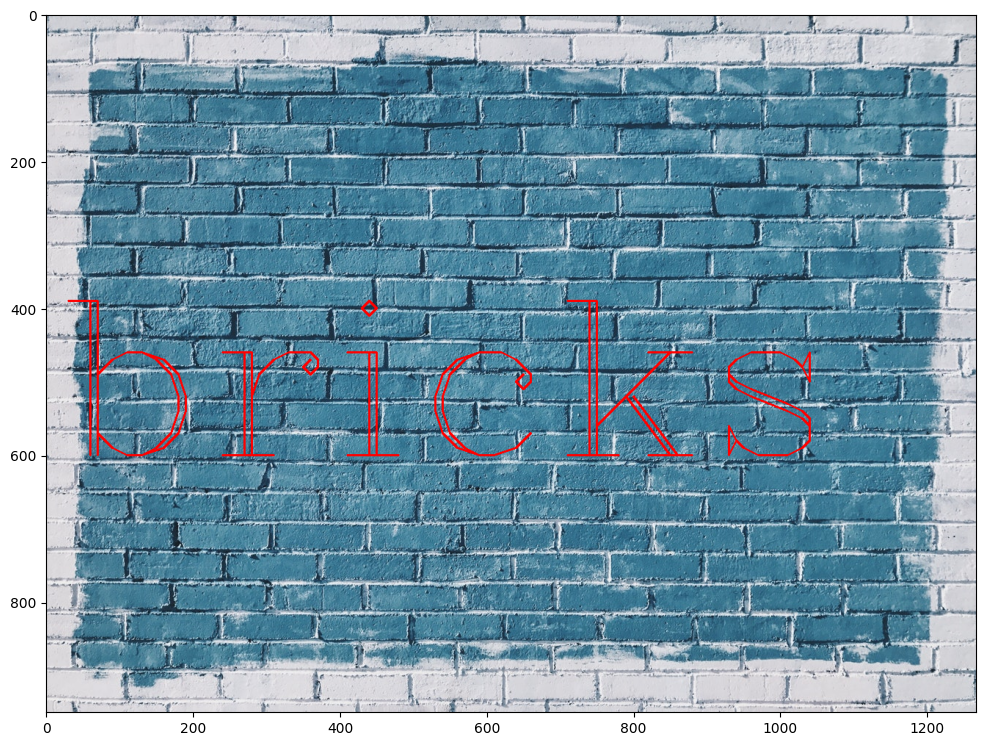

In [30]:
display_img(img)

In [40]:
kernel = np.ones(shape=(5,5), dtype=np.float32) / 25

In [18]:
kernel

array([[0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04]], dtype=float32)

In [23]:
1/25

0.04

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


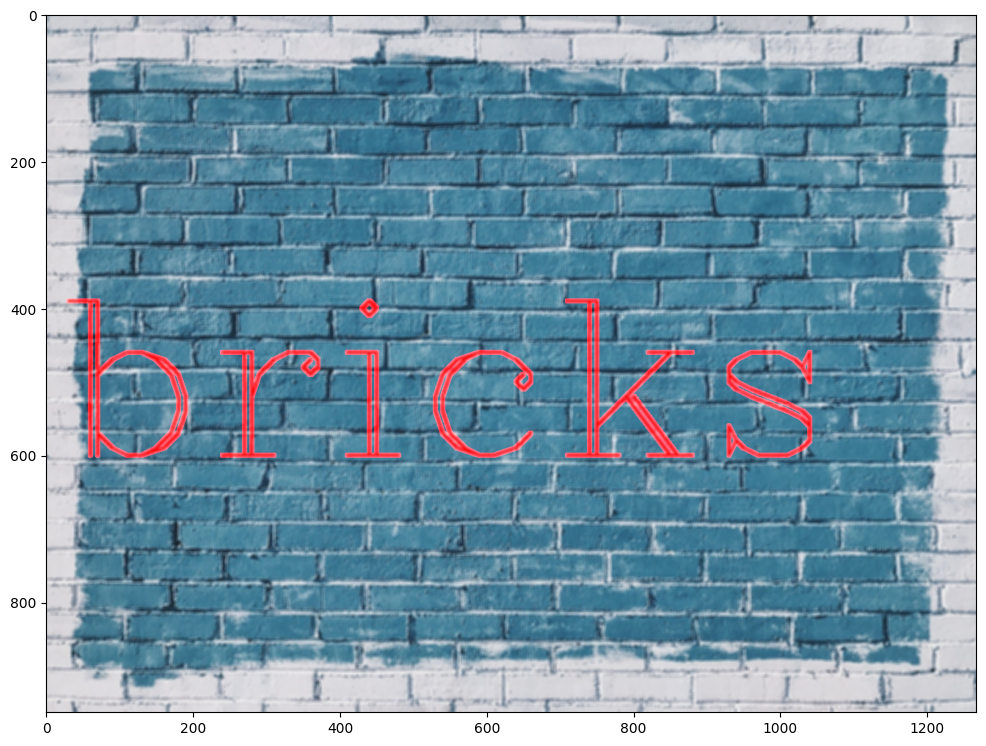

In [41]:
dst = cv2.filter2D(img,-1,kernel)
display_img(dst)

In [43]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img,text='bricks', org=(10,600), fontFace=font,fontScale=10,color=(255,0,0),thickness=2)
print('reset')


reset


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


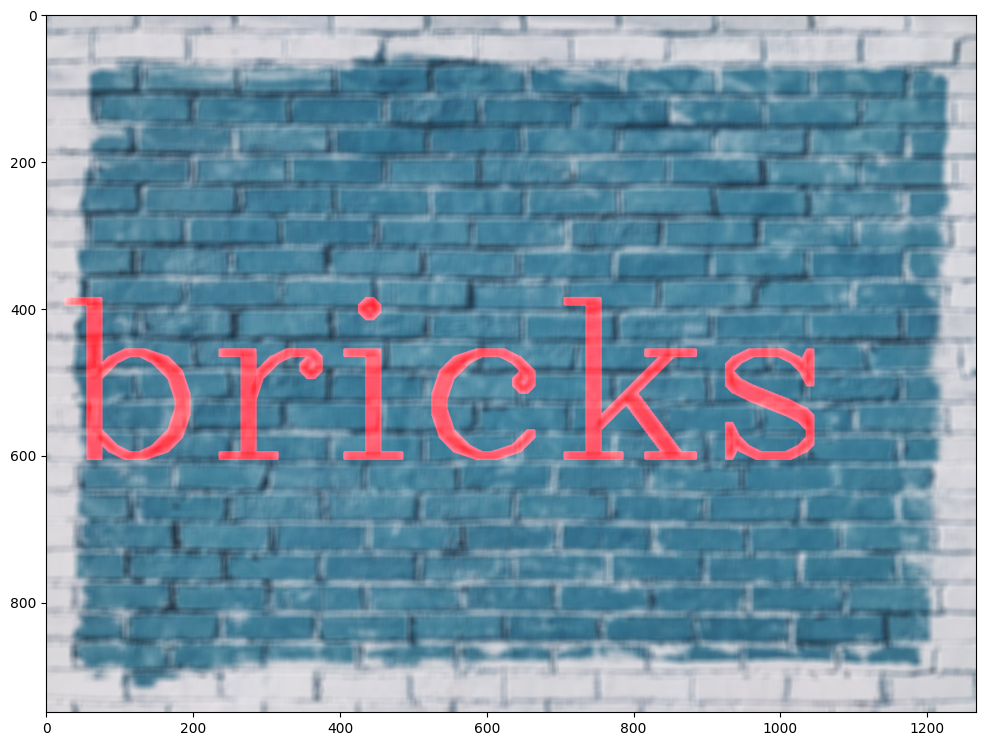

In [46]:
blurred = cv2.blur(img,ksize=(10,10))
display_img(blurred)

In [47]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img,text='bricks', org=(10,600), fontFace=font,fontScale=10,color=(255,0,0),thickness=2)
print('reset')

reset


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


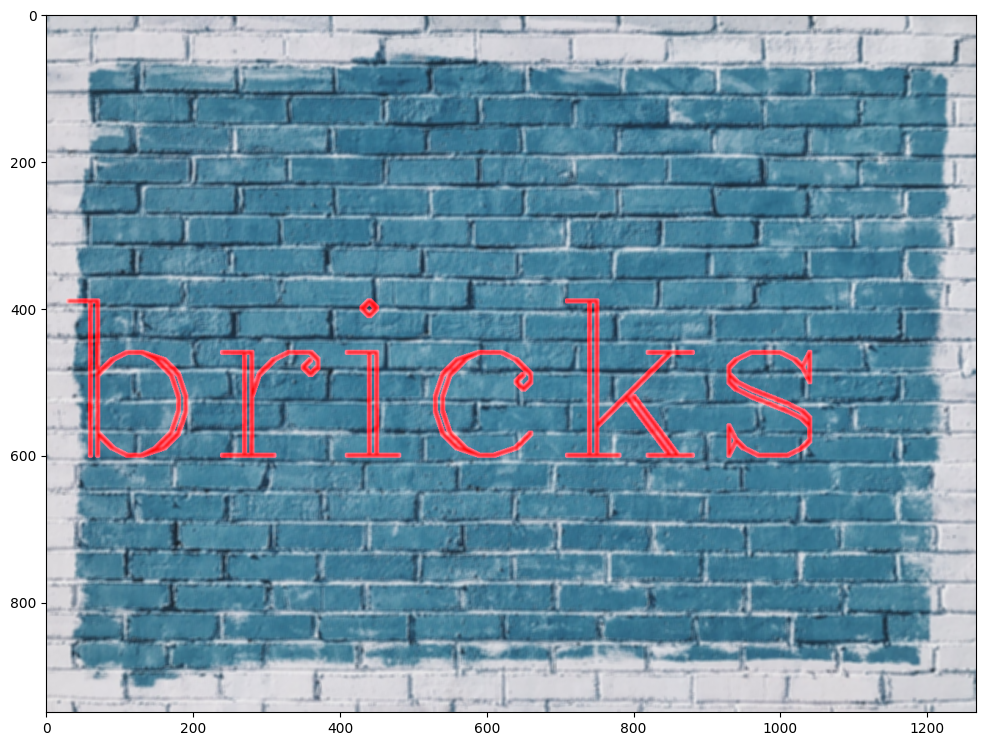

In [48]:
blurred_img = cv2.GaussianBlur(img,(5,5),10)
display_img(blurred_img)

In [49]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img,text='bricks', org=(10,600), fontFace=font,fontScale=10,color=(255,0,0),thickness=2)
print('reset')

reset


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


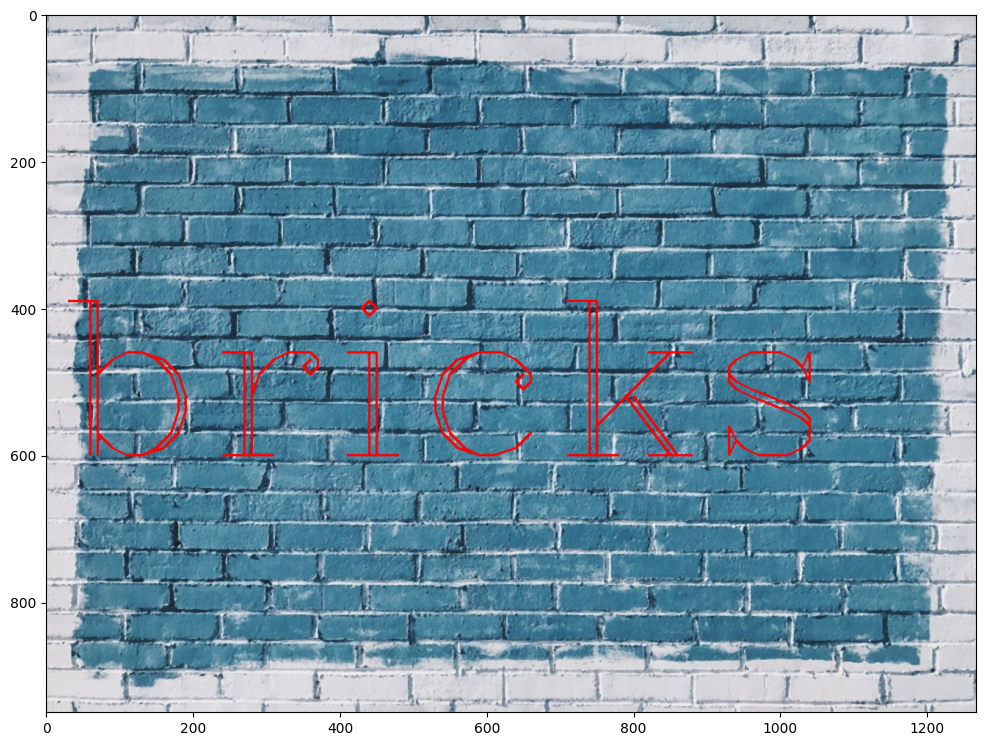

In [54]:
median_result = cv2.medianBlur(img,3)
display_img(median_result)

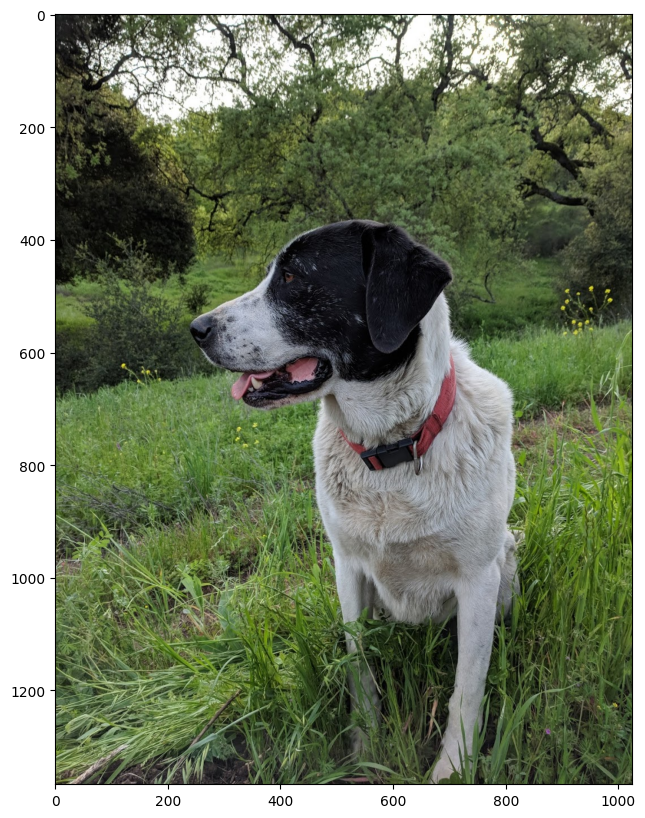

In [55]:
img = cv2.imread('DATA/sammy.jpg')
img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
display_img(img)

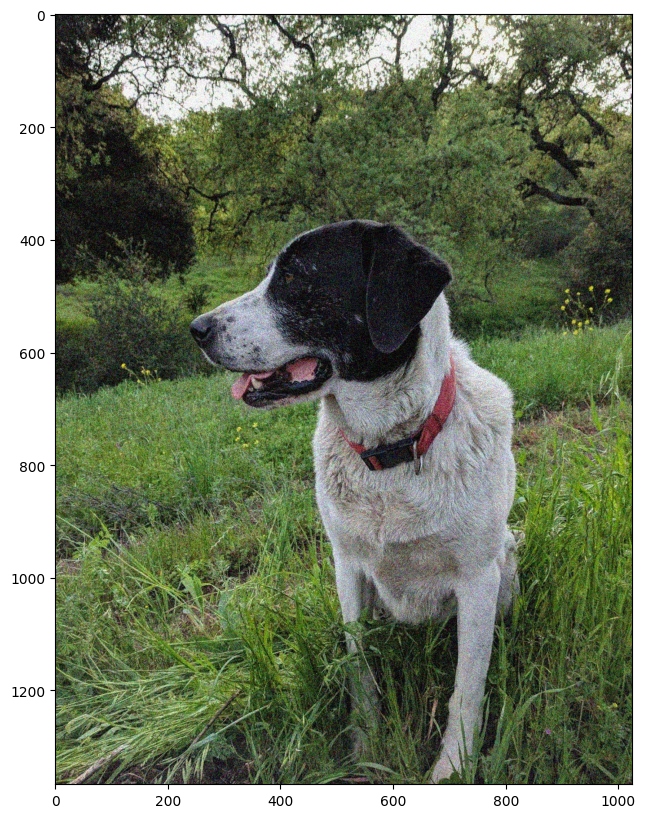

In [57]:
noise_img = cv2.imread('DATA/sammy_noise.jpg')
display_img(noise_img)

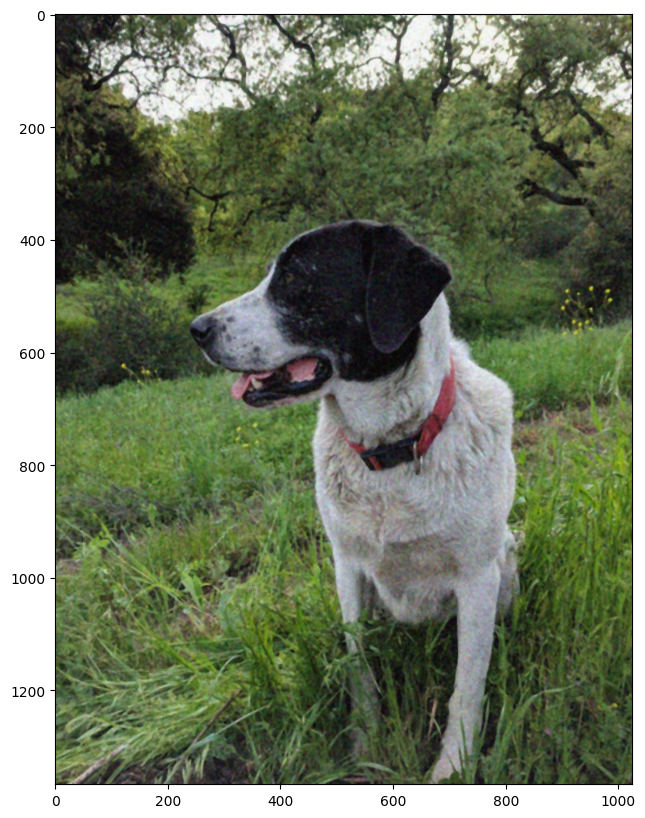

In [58]:
median = cv2.medianBlur(noise_img,5)
display_img(median)

In [60]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img,text='bricks', org=(10,600), fontFace=font,fontScale=10,color=(255,0,0),thickness=2)
print('reset')

reset


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


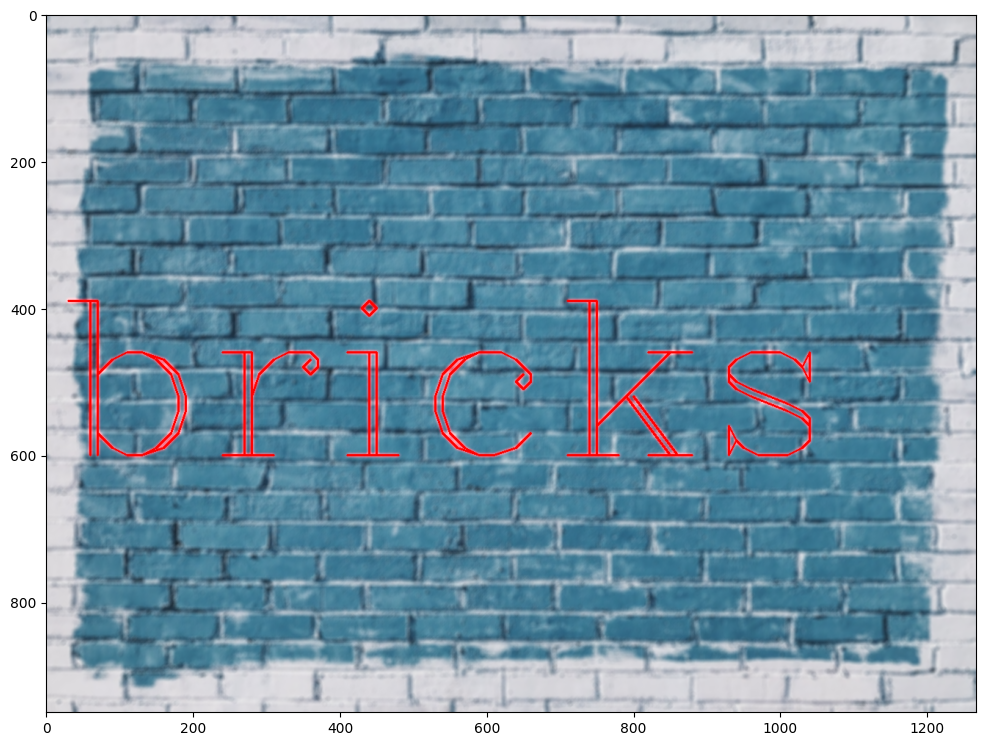

In [61]:
blur = cv2.bilateralFilter(img,9,75,75)
display_img(blur)

## Morphological operators

In [63]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline


In [78]:
def load_img():
  blank_img = np.zeros((600,600))
  font = cv2.FONT_HERSHEY_SIMPLEX
  cv2.putText(blank_img,'ABCDE',(50,300),fontFace=font,fontScale=5,color=(255,255,255),thickness=30)
  return blank_img

In [74]:
def display_img(img):
  fig = plt.figure(figsize=(12,10))
  ax = fig.add_subplot(111)
  ax.imshow(img,cmap='gray')

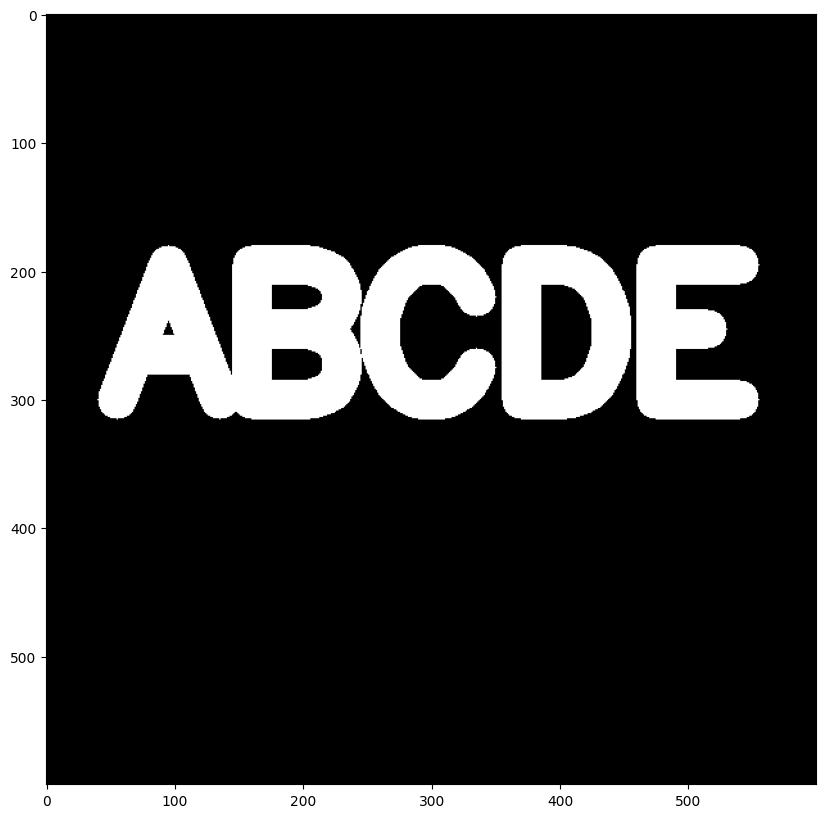

In [83]:
img = load_img()
display_img(img)

In [80]:
kernel = np.ones((5,5),dtype=np.uint8)
kernel

array([[1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1]], dtype=uint8)

In [84]:
result = cv2.erode(img,kernel,iterations=4)

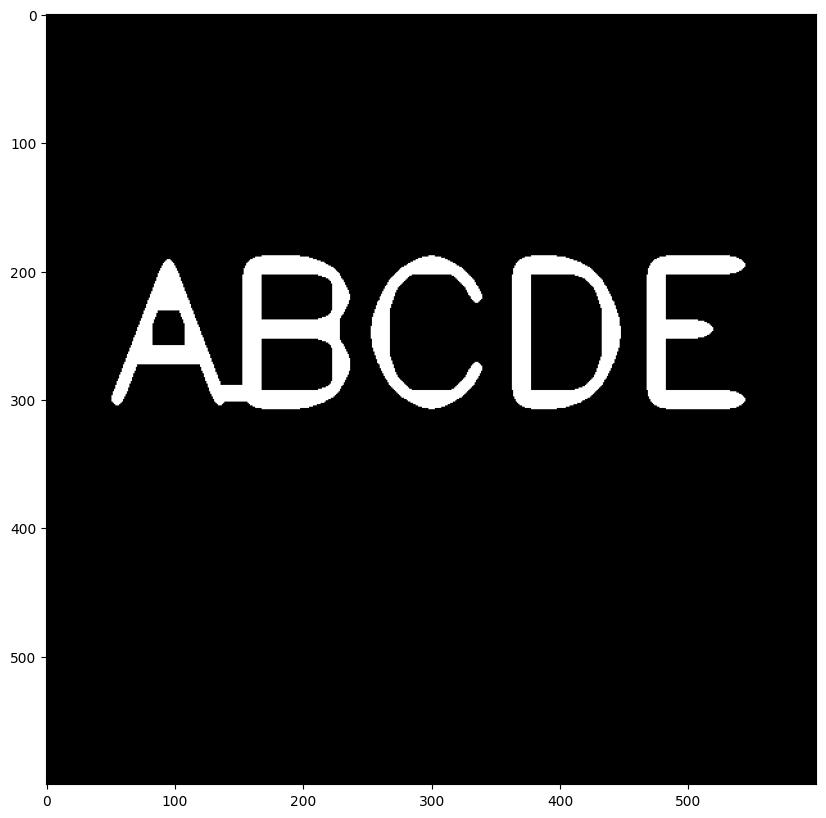

In [85]:
display_img(result)

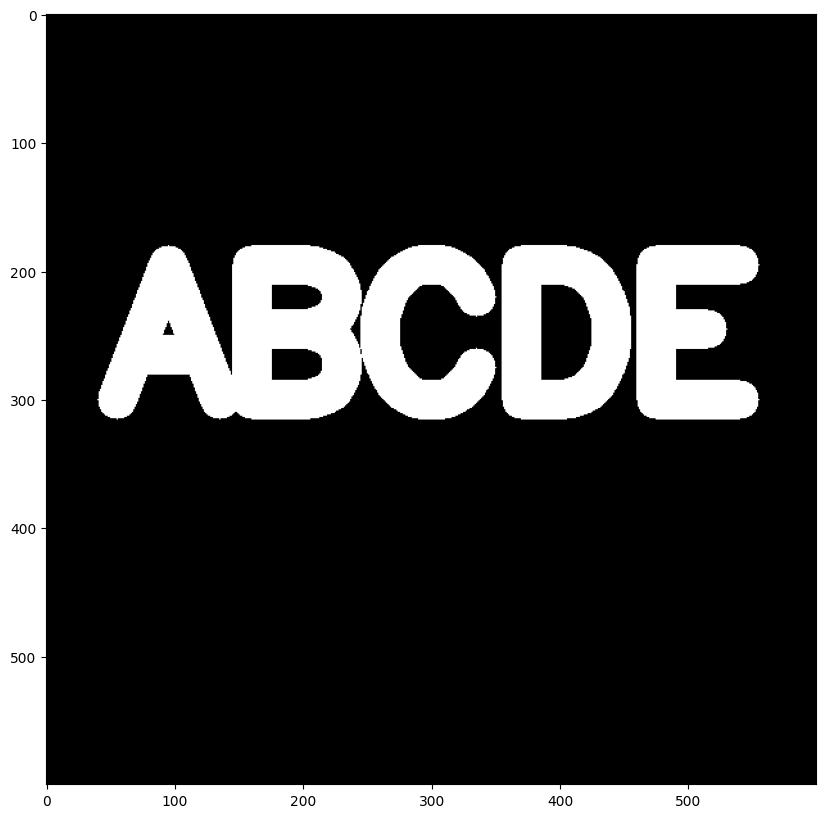

In [101]:
img = load_img()
display_img(img)

In [102]:
white_noise = np.random.randint(low=0,high=2,size=(600,600))

In [103]:
white_noise

array([[0, 0, 0, ..., 0, 0, 1],
       [0, 1, 0, ..., 1, 0, 0],
       [0, 0, 0, ..., 1, 1, 0],
       ...,
       [1, 0, 1, ..., 1, 1, 1],
       [1, 0, 1, ..., 0, 1, 1],
       [0, 1, 0, ..., 0, 0, 0]])

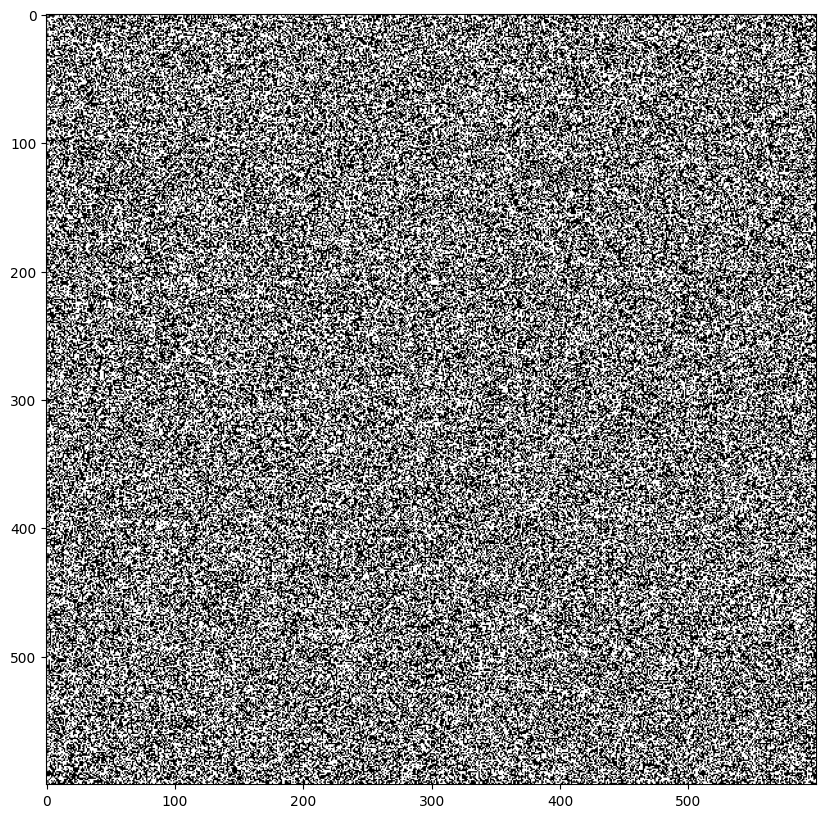

In [104]:
display_img(white_noise)

In [105]:
img.max()

255.0

In [106]:
white_noise = white_noise * 255

In [107]:
noise_img = white_noise + img

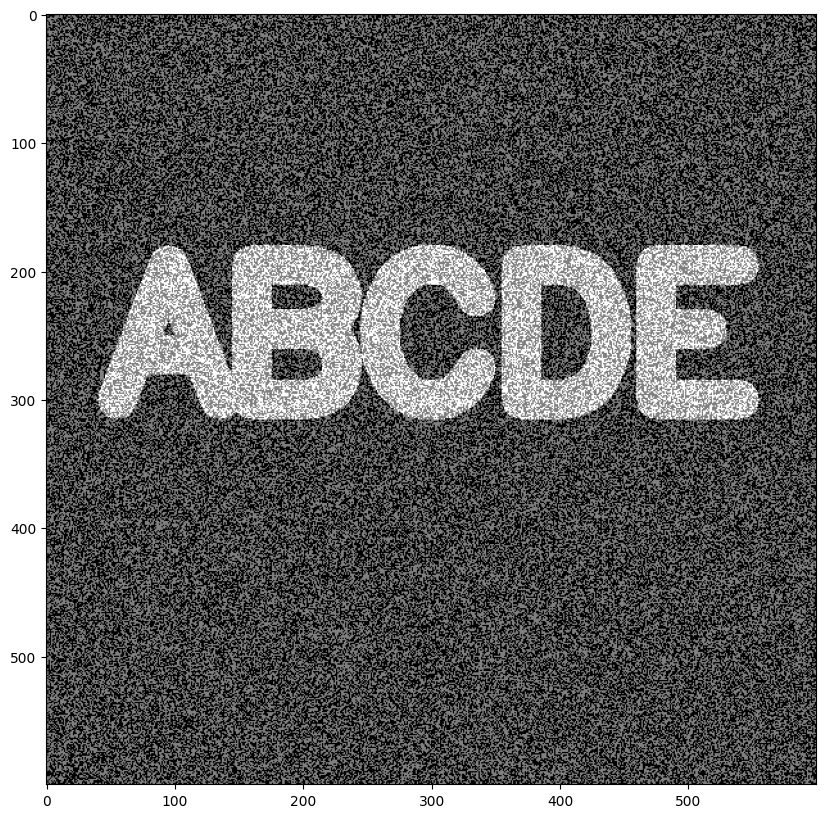

In [108]:
display_img(noise_img)

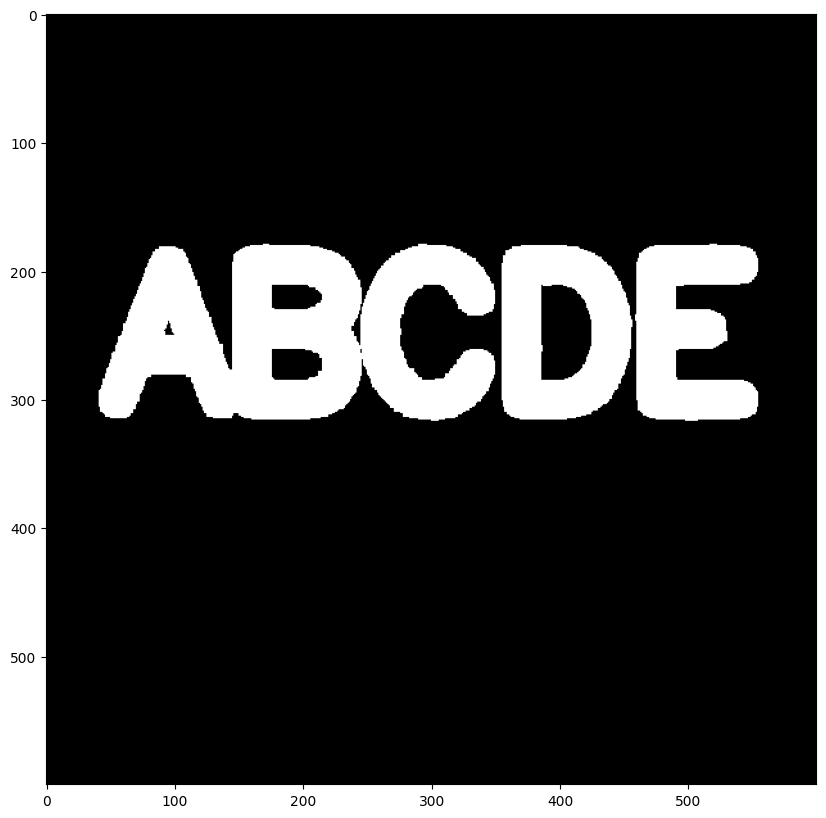

In [109]:
opening = cv2.morphologyEx(noise_img,cv2.MORPH_OPEN, kernel)
display_img(opening)

In [110]:
img = load_img()

In [112]:
black_noise = np.random.randint(low=0,high=2,size=(600,600))

In [113]:
black_noise = black_noise * -255

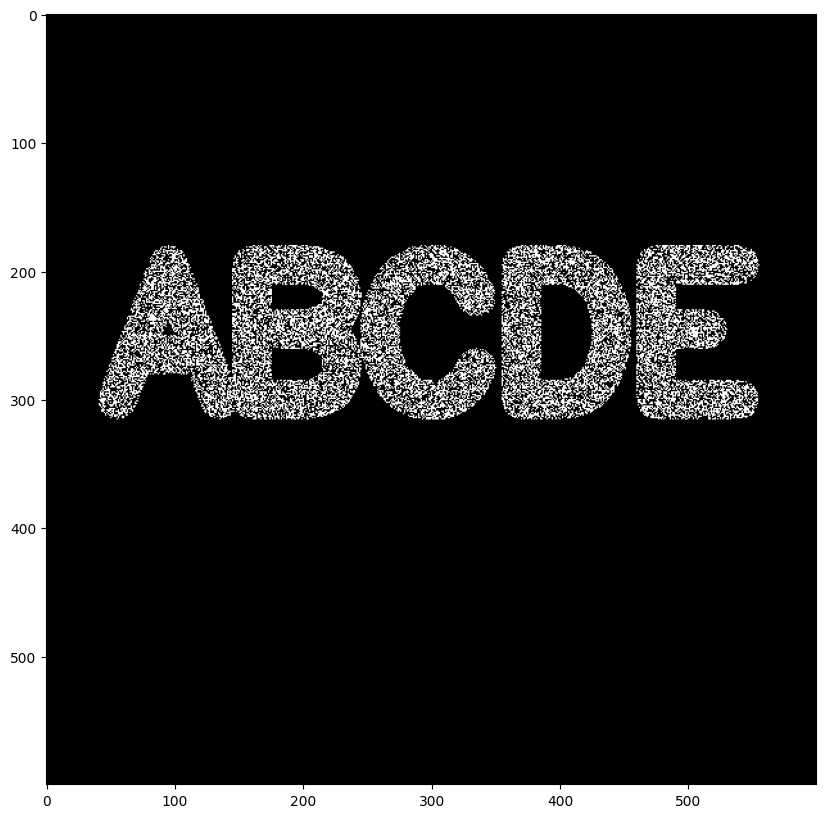

In [115]:
black_noise_img = img + black_noise
black_noise_img[black_noise_img==-255] = 0
display_img(black_noise_img)

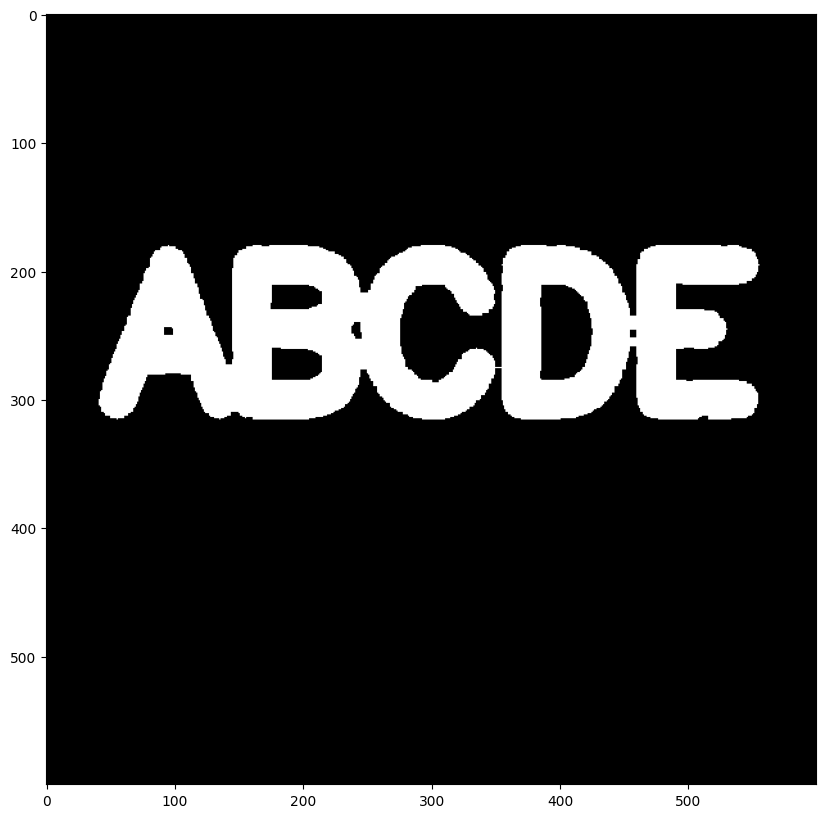

In [116]:
closing = cv2.morphologyEx(black_noise_img,cv2.MORPH_CLOSE,kernel)
display_img(closing)

In [118]:
img = load_img()

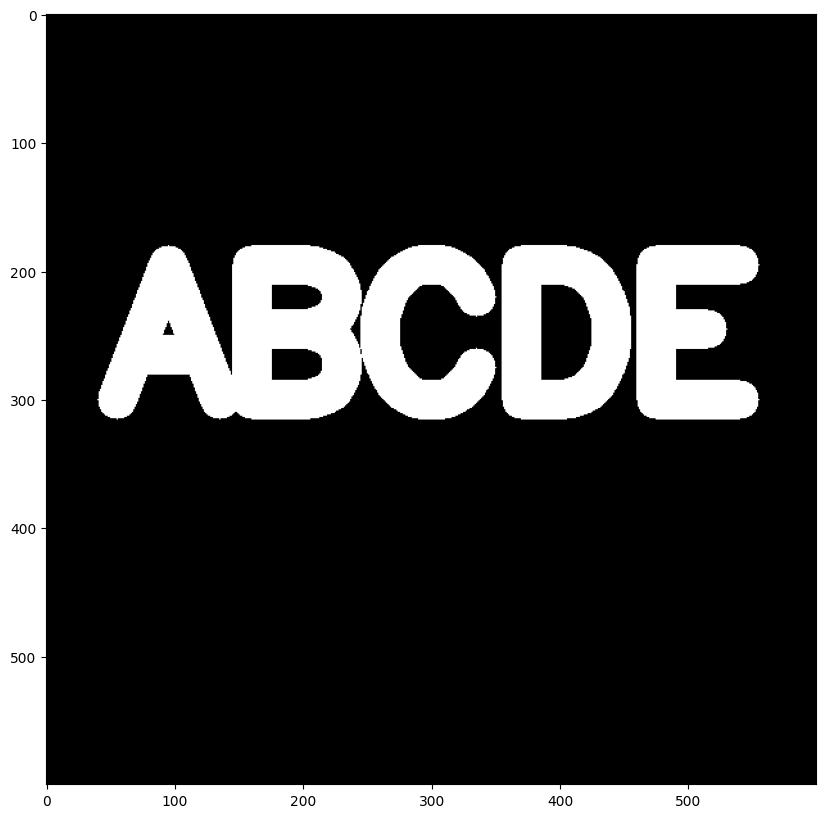

In [119]:
display_img(img)

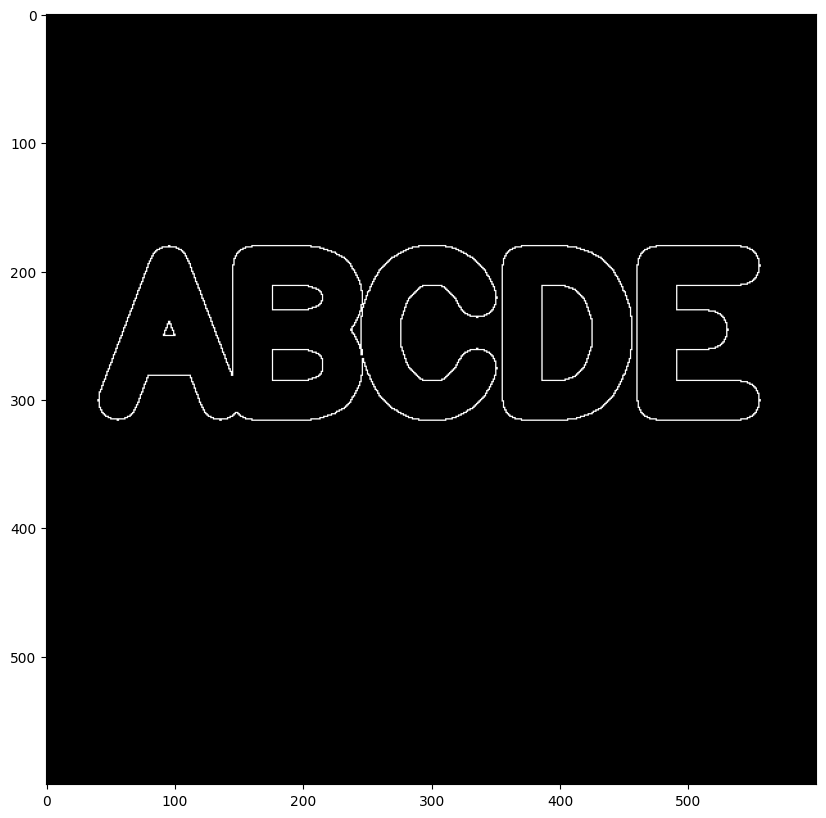

In [128]:
kernel = np.ones((2,2),dtype=np.uint8)
gradient = cv2.morphologyEx(img,cv2.MORPH_GRADIENT,kernel)
display_img(gradient)

## Gradients
### Edge detecting

In [129]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [140]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
def display_img(img):
  fig = plt.figure(figsize=(12,10))
  ax = fig.add_subplot(111)
  ax.imshow(img,cmap='gray')

In [144]:
img = cv2.imread('DATA/sudoku.jpg',0)

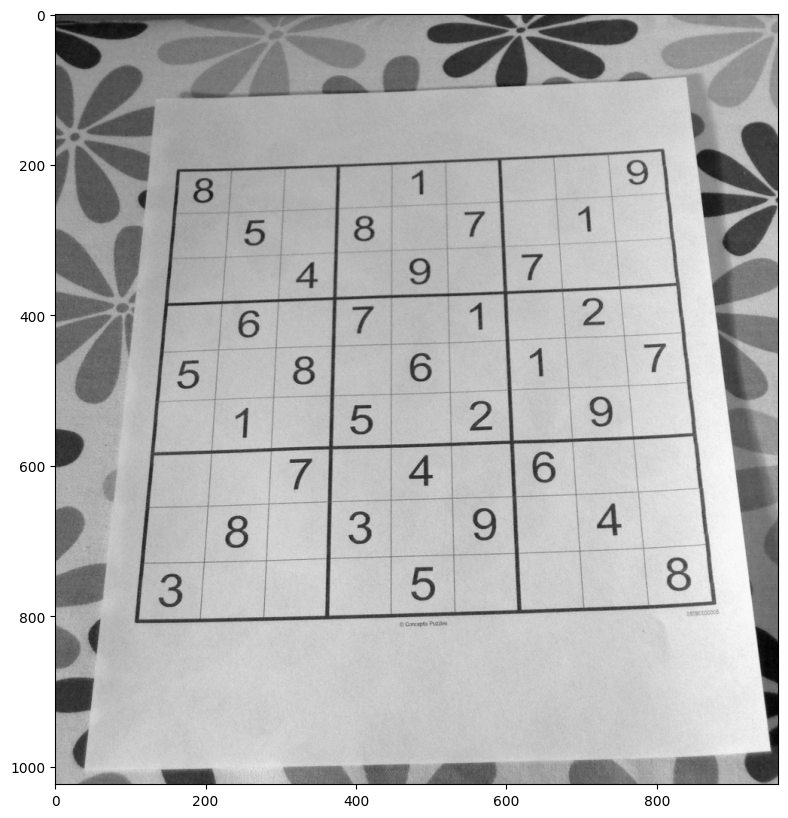

In [145]:
display_img(img)

In [146]:
sobelx = cv2.Sobel(img,cv2.CV_64F,1,0,ksize=5)

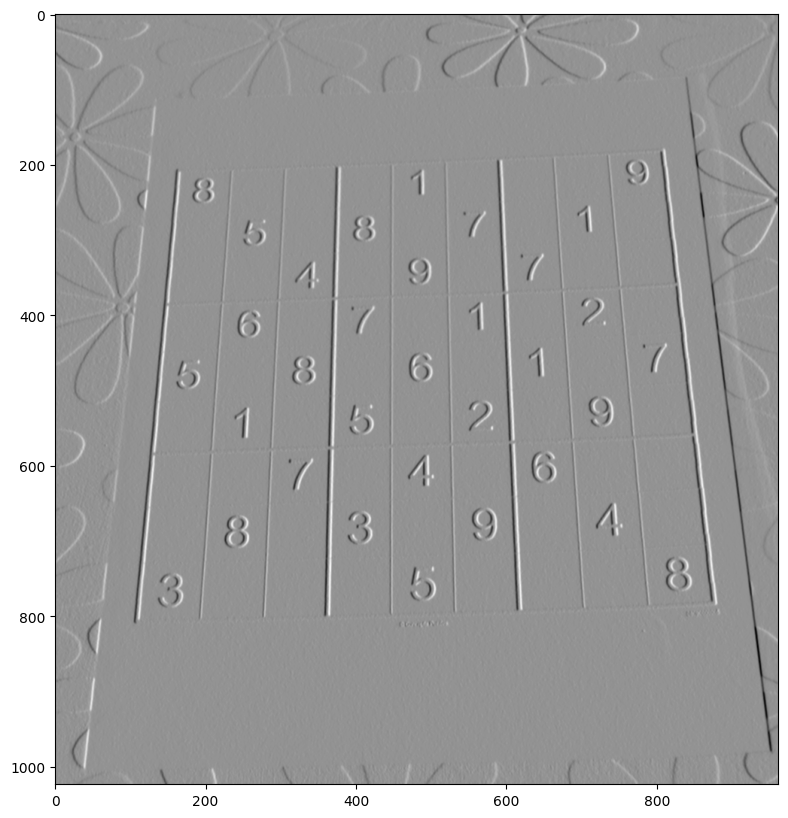

In [147]:
display_img(sobelx)

In [154]:
sobely = cv2.Sobel(img,cv2.CV_64F,0,1,ksize=5)


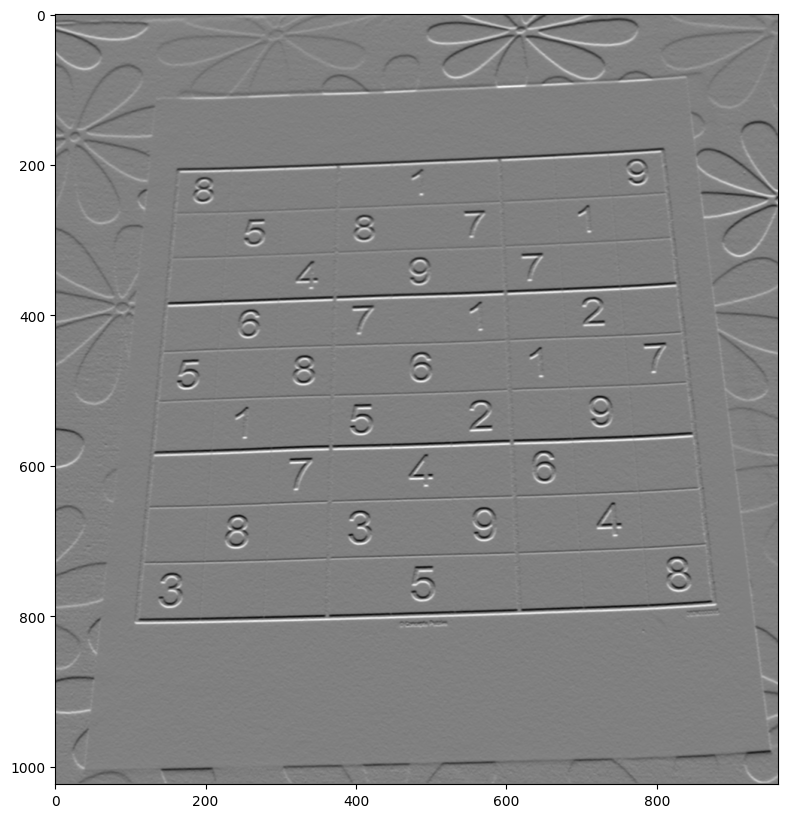

In [150]:
display_img(sobely)

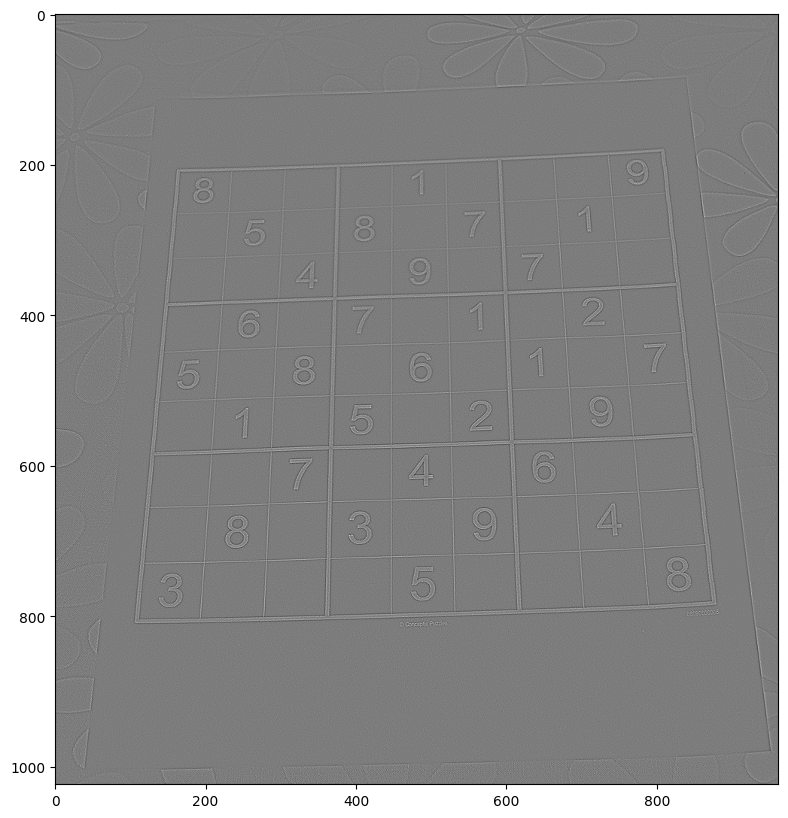

In [151]:
laplacian = cv2.Laplacian(img,cv2.CV_64F)
display_img(laplacian)

In [155]:
blended = cv2.addWeighted(src1=sobelx,alpha=0.5,src2=sobely,beta=0.5,gamma=0)

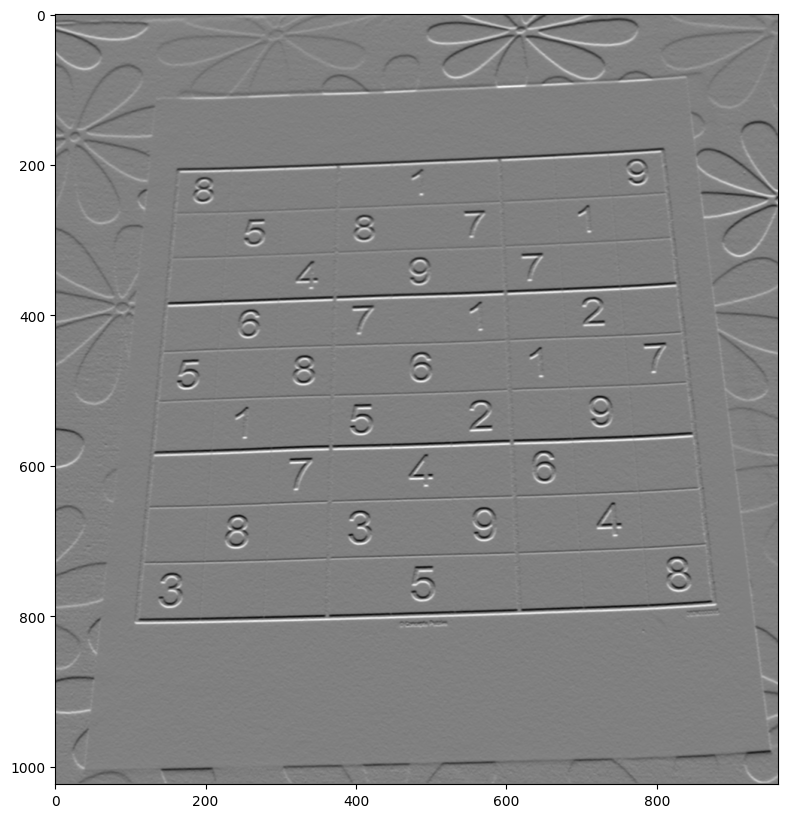

In [156]:
display_img(blended)

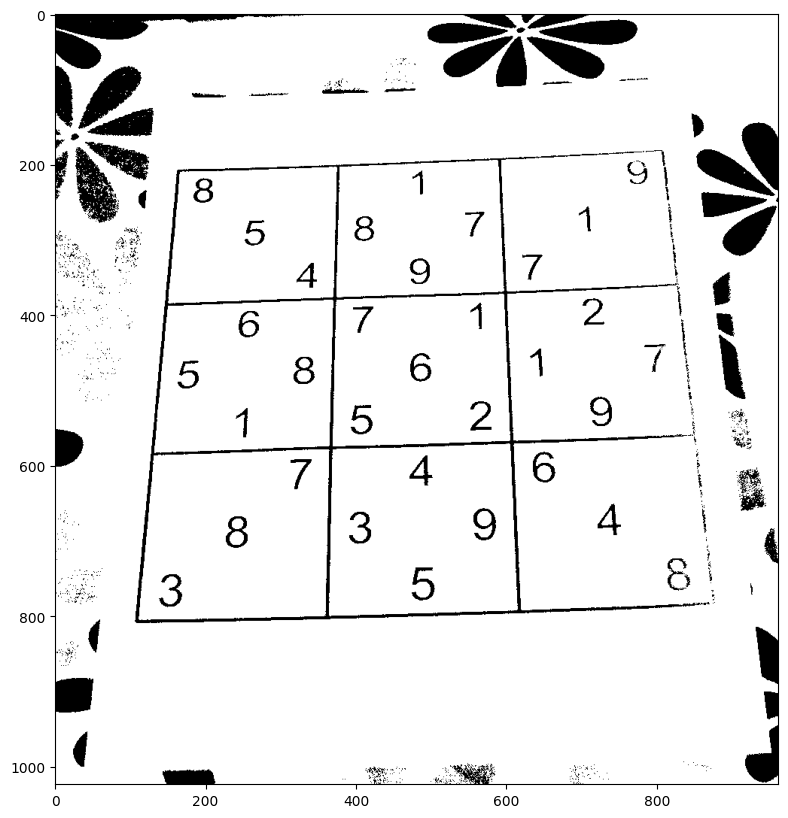

In [159]:
ret,th1 = cv2.threshold(img,100,255,cv2.THRESH_BINARY)
display_img(th1)

In [160]:
kernel = np.ones((4,4),np.uint8)

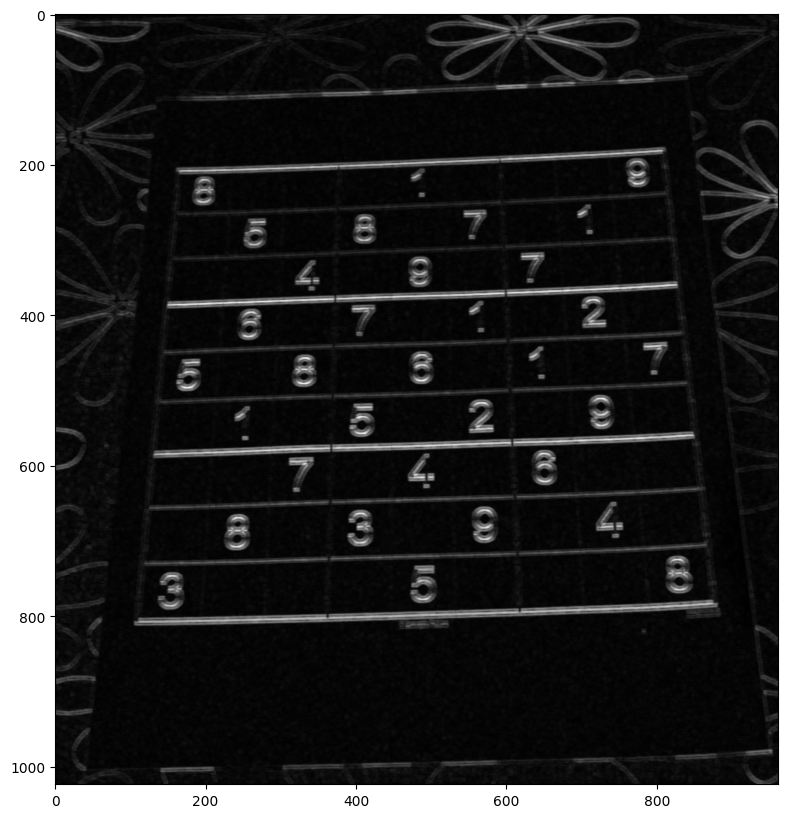

In [163]:
gradient = cv2.morphologyEx(blended, cv2.MORPH_GRADIENT,kernel)
display_img(gradient)

## HISTOGRAMS

In [165]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
def display_img(img):
  fig = plt.figure(figsize=(12,10))
  ax = fig.add_subplot(111)
  ax.imshow(img,cmap='gray')

In [168]:
dark_horse = cv2.imread('DATA/horse.jpg')
show_horse = cv2.cvtColor(dark_horse, cv2.COLOR_BGR2RGB)

rainbow = cv2.imread('DATA/rainbow.jpg')
show_rainbow = cv2.cvtColor(rainbow, cv2.COLOR_BGR2RGB)

bricks = cv2.imread('DATA/bricks.jpg')
show_bricks = cv2.cvtColor(bricks, cv2.COLOR_BGR2RGB)

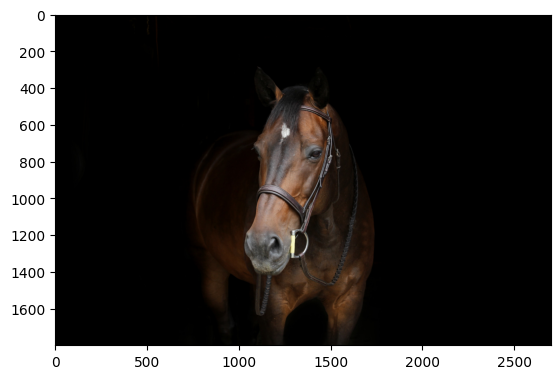

In [169]:
plt.imshow(show_horse)

In [173]:
# opencv bgr
hist_values = cv2.calcHist([show_horse], channels=[0], mask=None, histSize=[256], ranges=[0,256])
hist_values.shape

(256, 1)

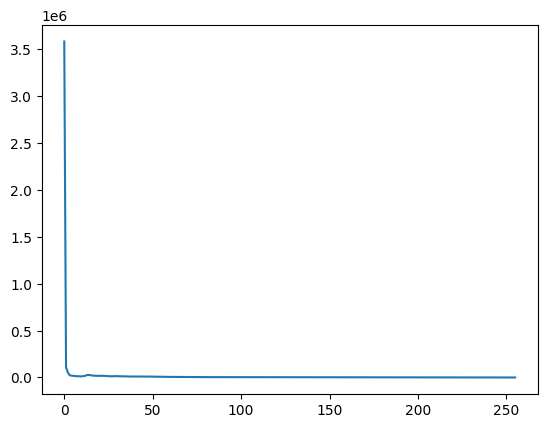

In [175]:
plt.plot(hist_values)

Text(0.5, 1.0, 'Histogram for bricks')

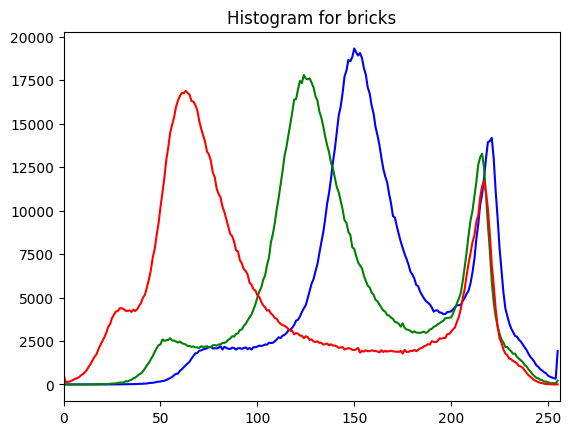

In [180]:
img = bricks
color = ('b','g','r')

for i,color in enumerate(color):
  hist = cv2.calcHist([img],[i],None,[256],[0,256])
  plt.plot(hist,color)
  plt.xlim([0,256])

plt.title('Histogram for bricks')

### histogram pt 2

In [181]:
# applying a mask and histogram

In [182]:
rainbow = cv2.imread('DATA/rainbow.jpg')
show_rainbow = cv2.cvtColor(rainbow, cv2.COLOR_BGR2RGB)

In [183]:
img = rainbow
img.shape

(550, 413, 3)

In [184]:
mask = np.zeros(img.shape[:2],np.uint8)

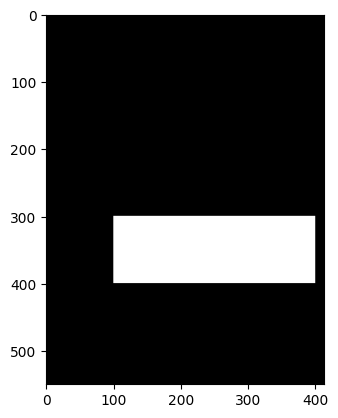

In [187]:
mask[300:400,100:400] = 255
plt.imshow(mask,cmap='gray')


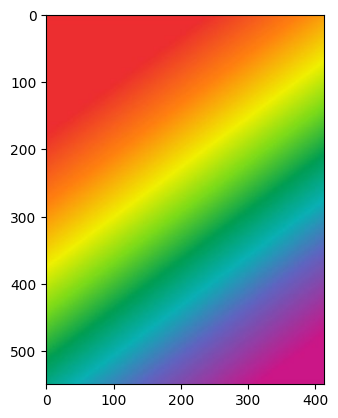

In [188]:
plt.imshow(show_rainbow)

In [189]:
masked_img = cv2.bitwise_and(img,img,mask=mask)

In [190]:
show_masked_img = cv2.bitwise_and(show_rainbow,show_rainbow,mask=mask)

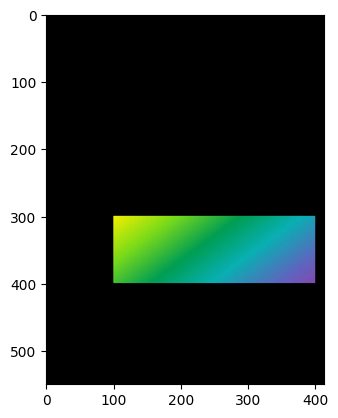

In [191]:
plt.imshow(show_masked_img)

In [193]:
# B G R
hist_mask_values_red = cv2.calcHist([rainbow],channels=[2],mask=mask, histSize=[256],ranges=[0,256])
hist_values_red = cv2.calcHist([rainbow],channels=[2],mask=None, histSize=[256],ranges=[0,256])

Text(0.5, 1.0, 'RED HISTOGRAM FOR MASKED RAINBOW')

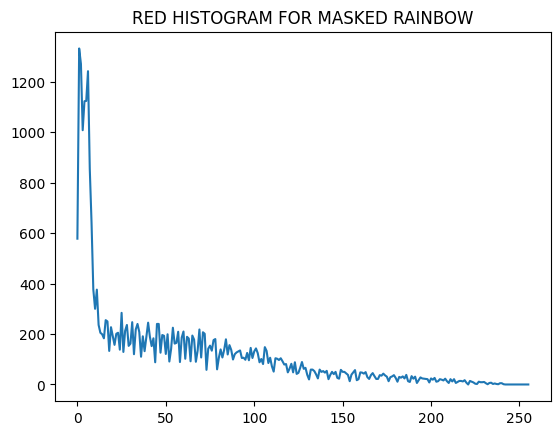

In [194]:
plt.plot(hist_mask_values_red)
plt.title('RED HISTOGRAM FOR MASKED RAINBOW')

Text(0.5, 1.0, 'RED HISTOGRAM RAINBOW')

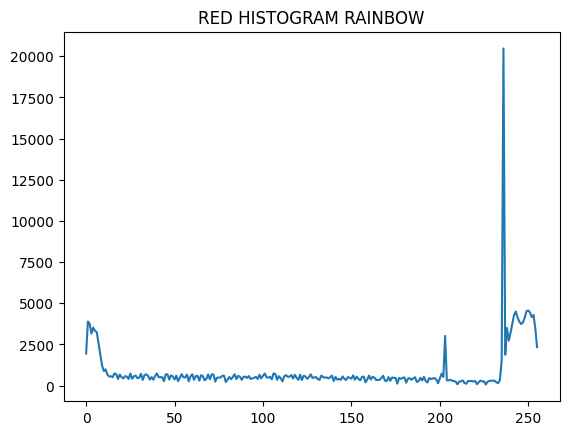

In [195]:
plt.plot(hist_values_red)
plt.title('RED HISTOGRAM RAINBOW')

## Hisogram equalization

In [205]:
gorilla = cv2.imread('DATA/gorilla.jpg',0)
def display(img,cmap=None):
  fig = plt.figure(figsize=(10,8))
  ax = fig.add_subplot(111)
  ax.imshow(img,cmap)

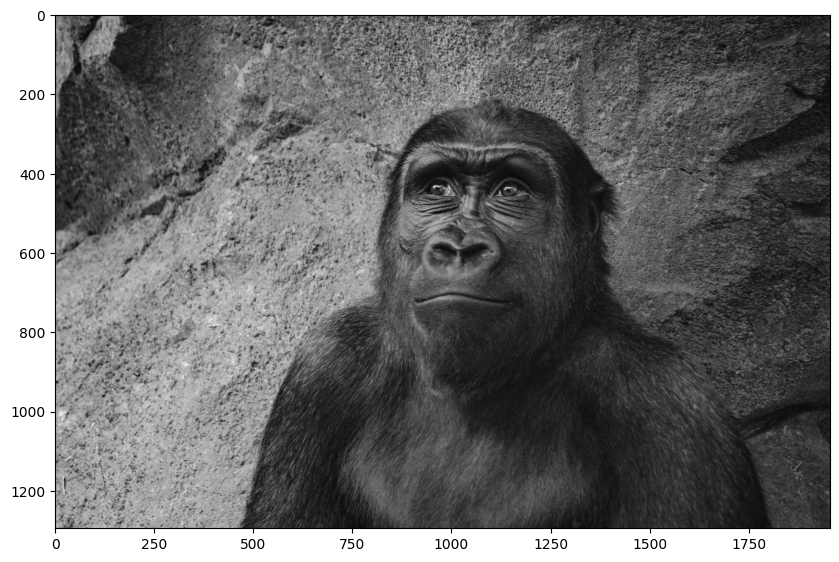

In [206]:
display(gorilla,cmap='gray')

In [207]:
hist_values = cv2.calcHist([gorilla],[0],mask=None,histSize=[256],ranges=[0,255])

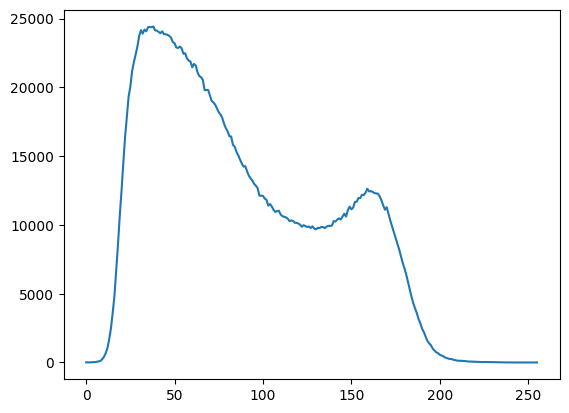

In [208]:
plt.plot(hist_values)

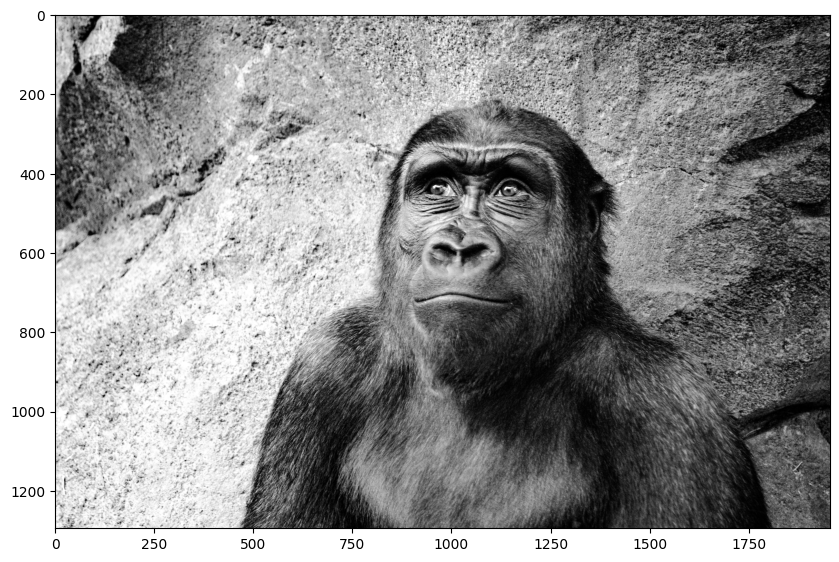

In [209]:
eq_gorilla = cv2.equalizeHist(gorilla)
display(eq_gorilla,cmap='gray')

In [210]:
hist_values = cv2.calcHist([eq_gorilla],[0],mask=None,histSize=[256],ranges=[0,255])

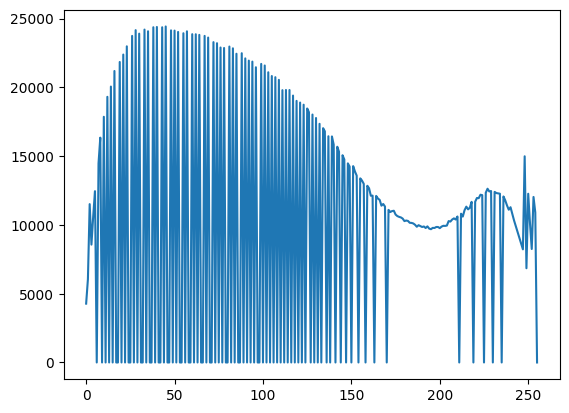

In [211]:
plt.plot(hist_values)

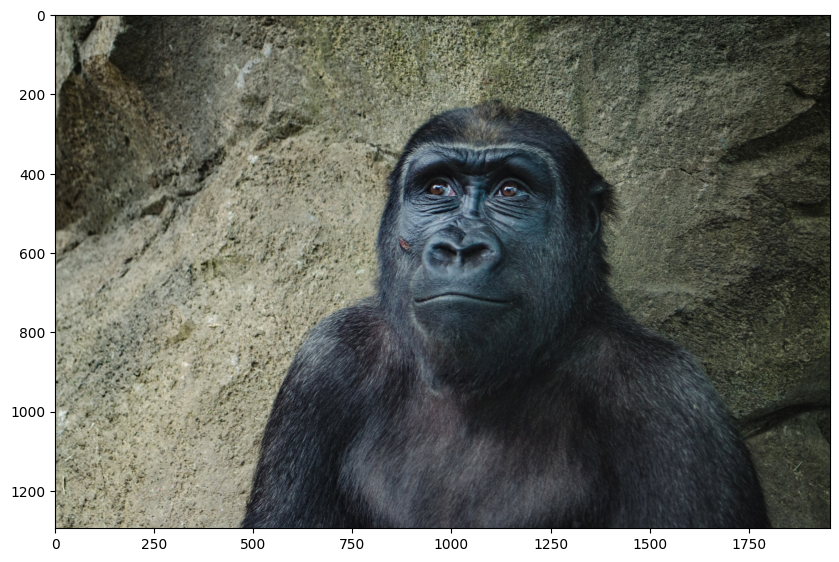

In [213]:
color_gorilla = cv2.imread('DATA/gorilla.jpg')
show_gorilla = cv2.cvtColor(color_gorilla,cv2.COLOR_BGR2RGB)
display(show_gorilla)

In [214]:
hsv = cv2.cvtColor(color_gorilla,cv2.COLOR_BGR2HSV)
hsv[:,:,2].max()

255

In [216]:
hsv[:,:,2] = cv2.equalizeHist(hsv[:,:,2])

In [217]:
eq_color_gorilla = cv2.cvtColor(hsv,cv2.COLOR_HSV2RGB)

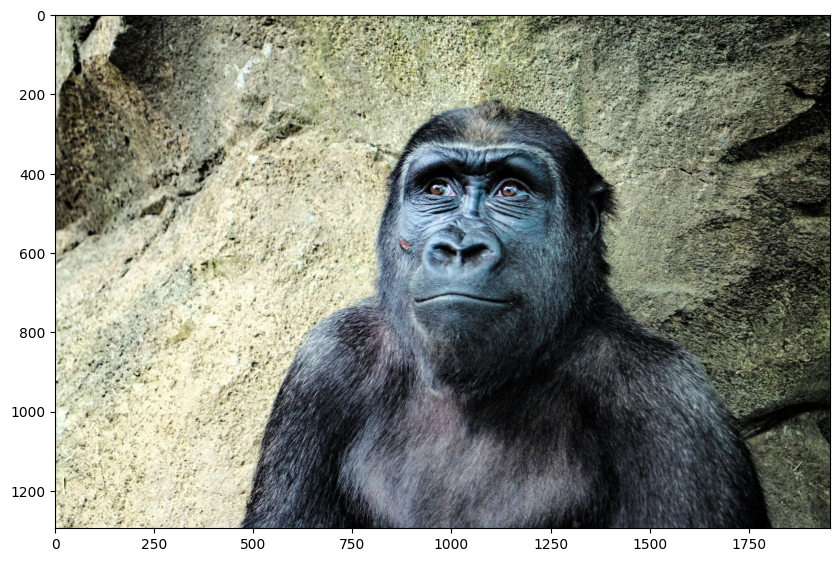

In [218]:
display(eq_color_gorilla)